In [55]:
import lightgbm as lgb
import numpy as np
import pandas as pd
import shap
import string
import matplotlib.pyplot as plt
import seaborn as sns
import random

from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import LabelEncoder
from scipy import stats
from scipy.special import inv_boxcox
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform
from sklearn.model_selection import (cross_val_score, train_test_split, 
                                     GridSearchCV, RandomizedSearchCV)


from utilidades.graficar import ver_dispersion
from utilidades.reducir_uso_memoria import reduce_mem_usage

In [53]:
train = pd.read_csv(f"{ruta_data}/train.csv", usecols=["habitaciones","provincia", "tipodepropiedad", "ciudad", "banos", "metrostotales", "metroscubiertos", "lat", "lng", "garages", "antiguedad", "idzona"])

In [7]:
pd.set_option('display.max_columns', None)  
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', -1)

In [8]:
ruta_data = "../data"
ruta_train = ruta_data + "/train.csv"
ruta_test = ruta_data + "/test.csv"
ruta_submits = "../submits"
ruta_features = ruta_data + "/features/"

In [9]:
def to_ascii(s):
    car_ascii = set(string.printable)
    return "".join([a for a in s if a in car_ascii])

train_limpio = reduce_mem_usage(pd.read_csv(f"{ruta_data}/train_limpio.csv"))
test_limpio = reduce_mem_usage(pd.read_csv(f"{ruta_data}/test_limpio.csv"))

train_limpio = train_limpio.drop(["dia"], axis=1)
test_limpio = test_limpio.drop(["dia"], axis=1)

poblacion_train = pd.read_csv(f"{ruta_data}/features/ftr_poblacion_train.csv")
poblacion_test = pd.read_csv(f"{ruta_data}/features/ftr_poblacion_test.csv")

train_limpio["poblacion"] = poblacion_train
test_limpio["poblacion"] = poblacion_test

train_limpio = train_limpio.rename(columns={col: to_ascii(col) for col in train_limpio.columns})
test_limpio = test_limpio.rename(columns={col: to_ascii(col) for col in test_limpio.columns})

id_zona_train = pd.read_csv(f"{ruta_data}/id_zona_train.csv")
id_zona_test = pd.read_csv(f"{ruta_data}/id_zona_test.csv")

train_limpio["idzona"] = id_zona_train["idzona"]
test_limpio["idzona"] = id_zona_test["idzona"]

In [10]:
tiene_terraza = pd.read_csv(f"{ruta_data}/features/tiene_terraza_train.csv")

train_limpio["tiene_terraza"] = tiene_terraza

tiene_terraza_tes = pd.read_csv(f"{ruta_data}/features/tiene_terraza_test.csv")

test_limpio["tiene_terraza"] = tiene_terraza_tes

tiene_jardin = pd.read_csv(f"{ruta_data}/features/tiene_jardin_train.csv")

train_limpio["tiene_jardin"] = tiene_jardin

tiene_jardin_tes = pd.read_csv(f"{ruta_data}/features/tiene_jardin_test.csv")

test_limpio["tiene_jardin"] = tiene_jardin_tes

tiene_servicio = pd.read_csv(f"{ruta_data}/features/tiene_servicio_train.csv")

train_limpio["tiene_servicio"] = tiene_servicio

tiene_servicio_tes = pd.read_csv(f"{ruta_data}/features/tiene_servicio_test.csv")

test_limpio["tiene_servicio"] = tiene_servicio_tes

tiene_vestidor = pd.read_csv(f"{ruta_data}/features/tiene_vestidor_train.csv")

train_limpio["tiene_vestidor"] = tiene_vestidor

tiene_vestidor_tes = pd.read_csv(f"{ruta_data}/features/tiene_vestidor_test.csv")

test_limpio["tiene_vestidor"] = tiene_vestidor_tes

tiene_vista = pd.read_csv(f"{ruta_data}/features/tiene_vista_train.csv")

train_limpio["tiene_vista"] = tiene_vista

tiene_vista_tes = pd.read_csv(f"{ruta_data}/features/tiene_vista_test.csv")

test_limpio["tiene_vista"] = tiene_vista_tes

tiene_salon = pd.read_csv(f"{ruta_data}/features/tiene_salon_train.csv")

train_limpio["tiene_salon"] = tiene_salon

tiene_salon_tes = pd.read_csv(f"{ruta_data}/features/tiene_salon_test.csv")

test_limpio["tiene_salon"] = tiene_salon_tes

tiene_cuarto = pd.read_csv(f"{ruta_data}/features/tiene_cuarto_train.csv")

train_limpio["tiene_cuarto"] = tiene_cuarto

tiene_cuarto_tes = pd.read_csv(f"{ruta_data}/features/tiene_cuarto_test.csv")

test_limpio["tiene_cuarto"] = tiene_cuarto_tes

tiene_family = pd.read_csv(f"{ruta_data}/features/tiene_family_train.csv")

train_limpio["tiene_family"] = tiene_family

tiene_family_tes = pd.read_csv(f"{ruta_data}/features/tiene_family_test.csv")

test_limpio["tiene_family"] = tiene_family_tes

tiene_bosque = pd.read_csv(f"{ruta_data}/features/tiene_bosque_dir_train.csv")

train_limpio["bosque_dir"] = tiene_bosque

tiene_bosque_tes = pd.read_csv(f"{ruta_data}/features/tiene_bosque_dir_test.csv")

test_limpio["bosque_dir"] = tiene_bosque_tes

tiene_avenida = pd.read_csv(f"{ruta_data}/features/tiene_avenida_dir_train.csv")

train_limpio["avenida_dir"] = tiene_avenida

tiene_avenida_tes = pd.read_csv(f"{ruta_data}/features/tiene_avenida_dir_test.csv")

test_limpio["avenida_dir"] = tiene_avenida_tes

tiene_fuente = pd.read_csv(f"{ruta_data}/features/tiene_fuente_dir_train.csv")

train_limpio["fuente_dir"] = tiene_fuente

tiene_fuente_tes = pd.read_csv(f"{ruta_data}/features/tiene_fuente_dir_test.csv")

test_limpio["fuente_dir"] = tiene_fuente_tes

#Empeoro

# tiene_vis = pd.read_csv(f"{ruta_data}/features/tiene_vista_dir_train.csv")

# train_limpio["vis_dir"] = tiene_vis

tiene_golf = pd.read_csv(f"{ruta_data}/features/tiene_golf_dir_train.csv")

train_limpio["golf_dir"] = tiene_golf

tiene_golf_tes = pd.read_csv(f"{ruta_data}/features/tiene_golf_dir_test.csv")

test_limpio["golf_dir"] = tiene_golf_tes

In [11]:
tiene_hectarea = pd.read_csv(f"{ruta_data}/features/tiene_hectarea_train.csv")

train_limpio["tiene_hectarea"] = tiene_hectarea

tiene_hectarea_tes = pd.read_csv(f"{ruta_data}/features/tiene_hectarea_test.csv")

test_limpio["tiene_hectarea"] = tiene_hectarea_tes

tiene_torre = pd.read_csv(f"{ruta_data}/features/tiene_torre_train.csv")

train_limpio["tiene_torre"] = tiene_torre

tiene_torre_tes = pd.read_csv(f"{ruta_data}/features/tiene_torre_test.csv")

test_limpio["tiene_torre"] = tiene_torre_tes

In [12]:
score_tf_train = pd.read_csv(f"{ruta_data}/features/scores_tfidf_train.csv")

train_limpio["score_tfidf"] = score_tf_train

In [13]:
score_tf_test = pd.read_csv(f"{ruta_data}/features/scores_tfidf_test.csv")

test_limpio["score_tfidf"] = score_tf_test

In [14]:
train = pd.read_csv(f"{ruta_data}/train.csv", usecols=["habitaciones","provincia", "tipodepropiedad", "ciudad", "banos", "metrostotales", "metroscubiertos", "lat", "lng", "garages", "antiguedad", "idzona"])

In [15]:
test = pd.read_csv(f"{ruta_data}/test.csv", usecols=["habitaciones","provincia", "tipodepropiedad", "ciudad", "banos", "metrostotales", "metroscubiertos", "lat", "lng"])

In [38]:
train_limpio["habitaciones"] = train["habitaciones"]
train_limpio["banos"] = train["banos"]

train_limpio["metroscubiertos"] = train["metroscubiertos"]
train_limpio["metrostotales"] = train["metrostotales"]

train_limpio["lat"] = train["lat"]
train_limpio["lng"] = train["lng"]

train_limpio["garages"] = train["garages"]
train_limpio["antiguedad"] = train["antiguedad"]
train_limpio["idzona"] = train["idzona"]
train_limpio["idzona"] = train_limpio["idzona"].fillna(0)

In [40]:
train_limpio["idzona"].min()

0.0

In [41]:
"""test_limpio["habitaciones"] = test["habitaciones"]
test_limpio["banos"] = test["banos"]

test_limpio["metroscubiertos"] = test["metroscubiertos"]
test_limpio["metrostotales"] = test["metrostotales"]

test_limpio["lat"] = test["lat"]
test_limpio["lng"] = test["lng"]"""

'test_limpio["habitaciones"] = test["habitaciones"]\ntest_limpio["banos"] = test["banos"]\n\ntest_limpio["metroscubiertos"] = test["metroscubiertos"]\ntest_limpio["metrostotales"] = test["metrostotales"]\n\ntest_limpio["lat"] = test["lat"]\ntest_limpio["lng"] = test["lng"]'

In [42]:
train_limpio["suma_metros"] = train_limpio["metrostotales"] + train_limpio["metroscubiertos"]
train_limpio["suma_metros"] = train_limpio["suma_metros"].fillna(train_limpio["metroscubiertos"])

In [14]:
"""test_limpio["suma_metros"] = test_limpio["metrostotales"] + test_limpio["metroscubiertos"]
test_limpio["suma_metros"] = test_limpio["suma_metros"].fillna(test_limpio["metroscubiertos"])
"""

In [43]:
train_limpio = train_limpio.drop([ftr for ftr in train_limpio.columns if ftr.startswith("tipodepropiedad")], axis=1)
train_limpio = train_limpio.drop([ftr for ftr in train_limpio.columns if ftr.startswith("provincia")], axis=1)

train_limpio["provincia"] = train["provincia"]
train_limpio["tipodepropiedad"] = train["tipodepropiedad"]
train_limpio["ciudad"] = train["ciudad"]

train_limpio["provincia"] = train_limpio["provincia"].fillna(train_limpio["provincia"].mode()[0])
train_limpio["tipodepropiedad"] = train_limpio["tipodepropiedad"].fillna(train_limpio["tipodepropiedad"].mode()[0])
train_limpio["ciudad"] = train_limpio.groupby("provincia")["ciudad"].apply(lambda x: x.fillna(x.mode()))
train_limpio["ciudad"] = train_limpio["ciudad"].fillna(train_limpio["ciudad"].mode()[0])

In [16]:
"""test_limpio = test_limpio.drop([ftr for ftr in test_limpio.columns if ftr.startswith("tipodepropiedad")], axis=1)
test_limpio = test_limpio.drop([ftr for ftr in test_limpio.columns if ftr.startswith("provincia")], axis=1)

test_limpio["provincia"] = test["provincia"]
test_limpio["tipodepropiedad"] = test["tipodepropiedad"]
test_limpio["ciudad"] = test["ciudad"]

test_limpio["provincia"] = test_limpio["provincia"].fillna(test_limpio["provincia"].mode()[0])
test_limpio["tipodepropiedad"] = test_limpio["tipodepropiedad"].fillna(test_limpio["tipodepropiedad"].mode()[0])
test_limpio["ciudad"] = test_limpio.groupby("provincia")["ciudad"].apply(lambda x: x.fillna(x.mode()))
test_limpio["ciudad"] = test_limpio["ciudad"].fillna(test_limpio["ciudad"].mode()[0])"""

In [34]:
def encontrar_ciudad_parecida(ciudad):
    poblacion = test_limpio[test_limpio["ciudad"]==ciudad].iloc[0]["poblacion"]
    return random.choice(list(train_limpio[(train_limpio["poblacion"]<poblacion+1000) & (train_limpio["poblacion"]>poblacion-1000)]["ciudad"]))

In [18]:
"""for ciu in test_limpio["ciudad"].unique():
    if ciu not in train_limpio["ciudad"].unique():
        test_limpio.loc[test_limpio["ciudad"]==ciu, "ciudad"] = encontrar_ciudad_parecida(ciu)"""

In [19]:
"""for ciu in test_limpio["ciudad"].unique():
    if ciu not in train_limpio["ciudad"].unique():
        print(ciu)"""

In [44]:
le_c = LabelEncoder()
le_p = LabelEncoder()
le_t = LabelEncoder()
le_i = LabelEncoder()

In [45]:
le_p.fit(train_limpio["provincia"])
le_t.fit(train_limpio["tipodepropiedad"])
le_c.fit(train_limpio["ciudad"])
le_i.fit(train_limpio["idzona"])
# le_i.fit(pd.concat([test_limpio["idzona"],train_limpio["idzona"]]))

LabelEncoder()

In [46]:
train_limpio["provincia"] = le_p.transform(train_limpio["provincia"])
train_limpio["tipodepropiedad"] = le_t.transform(train_limpio["tipodepropiedad"])
train_limpio["ciudad"] = le_c.transform(train_limpio["ciudad"])
train_limpio["idzona"] = le_i.transform(train_limpio["idzona"])

In [23]:
"""test_limpio["provincia"] = le_p.transform(test_limpio["provincia"])
test_limpio["tipodepropiedad"] = le_t.transform(test_limpio["tipodepropiedad"])
test_limpio["ciudad"] = le_c.transform(test_limpio["ciudad"])
test_limpio["idzona"] = le_i.transform(test_limpio["idzona"])"""

In [47]:
train_limpio.shape

(240000, 37)

In [48]:
test_limpio.shape

(60000, 86)

In [49]:
X, y = train_limpio.drop(["precio"], axis=1),train_limpio["precio"]

In [50]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=96969)

In [51]:
%%time
d_train = lgb.Dataset(X_train, label= y_train, categorical_feature=["provincia",
                                                                    "tipodepropiedad",
                                                                    "ciudad",
                                                                    "tiene_terraza",
                                                                    "tiene_jardin",
                                                                    "tiene_servicio",
                                                                    "tiene_vestidor",
                                                                    "tiene_vista",
                                                                    "tiene_salon",
                                                                    "tiene_cuarto",
                                                                    "tiene_family",
                                                                    "bosque_dir",
                                                                    "avenida_dir",
                                                                    "fuente_dir",
                                                                    "golf_dir",
                                                                    "tiene_hectarea",
                                                                    "tiene_torre",
                                                                    "idzona"])

params = {"feature_fraction":0.5959853966635414,
          "lambda_l1":80.82894063964651,
          "learning_rate": 0.07141681335686303, #0.05141681335686303
          "max_bin":1000,
          "min_data_in_leaf":20,
          "num_iterations":2000,
          "num_leaves":250,
          "reg_sqrt":True,
          "n_jobs":-1
}

reg = lgb.train(params,d_train)
pred = reg.predict(X_test)

/home/julian/.local/lib/python3.7/site-packages/lightgbm/engine.py:148: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))
/home/julian/.local/lib/python3.7/site-packages/lightgbm/basic.py:1243: UserWarning: Using categorical_feature in Dataset.
  warnings.warn('Using categorical_feature in Dataset.')


CPU times: user 10min 25s, sys: 3.92 s, total: 10min 29s
Wall time: 3min 3s


In [52]:
mean_absolute_error(y_test, pred)

476279.2631808287

In [57]:
n_dimensiones = 300

In [58]:
desc_train = pd.read_csv(f"{ruta_data}/features/descr_vectorizadas_train_{n_dimensiones}d.csv")

In [59]:
desc_train = reduce_mem_usage(desc_train)

In [28]:
#desc_test = pd.read_csv(f"{ruta_data}/features/descr_vectorizadas_test_{n_dimensiones}d.csv")

In [60]:
tit_train = pd.read_csv(f"{ruta_data}/features/titulos_vectorizados_train_50d.csv")

In [61]:
# tit_test = pd.read_csv(f"{ruta_data}/features/titulos_vectorizados_test_50d.csv")

In [62]:
train_lim_des = pd.concat([train_limpio, desc_train, tit_train], axis=1)

In [32]:
# test_lim_des = pd.concat([test_limpio, desc_test, tit_test], axis=1)

In [63]:
X, y = train_lim_des.drop(["precio"], axis=1),train_lim_des["precio"]

In [64]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=96969)

In [65]:
%%time
d_train = lgb.Dataset(X_train, label= y_train, categorical_feature=["provincia",
                                                                    "tipodepropiedad",
                                                                    "ciudad",
                                                                    "tiene_terraza",
                                                                    "tiene_jardin",
                                                                    "tiene_servicio",
                                                                    "tiene_vestidor",
                                                                    "tiene_vista",
                                                                    "tiene_salon",
                                                                    "tiene_cuarto",
                                                                    "tiene_family",
                                                                    "bosque_dir",
                                                                    "avenida_dir",
                                                                    "fuente_dir",
                                                                    "golf_dir",
                                                                    "tiene_hectarea",
                                                                    "tiene_torre",
                                                                    "idzona"])

params = {"feature_fraction":0.5959853966635414,
          "lambda_l1":80.82894063964651,
          "learning_rate": 0.07141681335686303, #0.05141681335686303
          "max_bin":1000,
          "min_data_in_leaf":20,
          "num_iterations":2000,
          "num_leaves":250,
          "reg_sqrt":True,
          "n_jobs":-1
}

reg = lgb.train(params,d_train)
pred = reg.predict(X_test)

/home/julian/.local/lib/python3.7/site-packages/lightgbm/engine.py:148: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))
/home/julian/.local/lib/python3.7/site-packages/lightgbm/basic.py:1243: UserWarning: Using categorical_feature in Dataset.
  warnings.warn('Using categorical_feature in Dataset.')


CPU times: user 22min 46s, sys: 8.36 s, total: 22min 54s
Wall time: 6min 29s


In [66]:
mean_absolute_error(y_test, pred)

454759.2504812385

In [67]:
shap.initjs()
reg.params['objective'] = 'regression'
explainer = shap.TreeExplainer(reg)
shap_values = explainer.shap_values(X_test.iloc[:1000,])

shap.force_plot(explainer.expected_value, shap_values, X_test.iloc[:1000,])

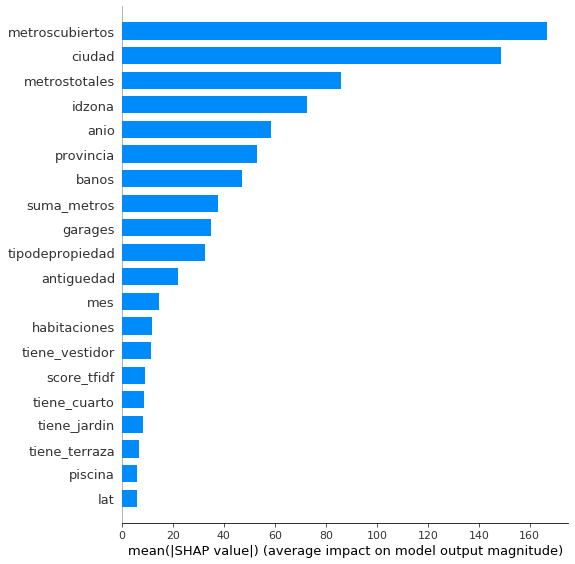

In [94]:
shap.summary_plot(shap_values, X_test.iloc[:1000], plot_type="bar", title="Feature importance")

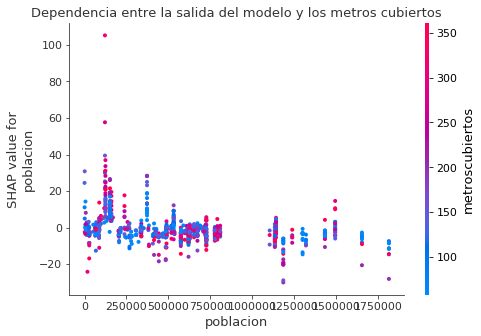

In [125]:
shap.dependence_plot("poblacion", shap_values, X_test.iloc[:1000], alpha=1, interaction_index="metroscubiertos", title="Dependencia entre la salida del modelo y los metros cubiertos")

In [127]:
shap_interaction_values = explainer.shap_interaction_values(X_test.iloc[:1000])

AttributeError: 'TreeEnsemble' object has no attribute 'values'

In [126]:
shap.summary_plot(shap_interaction_values, X_test.iloc[:1000])

NameError: name 'shap_interaction_values' is not defined

In [68]:
pred = reg.predict(test_lim_des)

In [69]:
ids_test = pd.read_csv(f"{ruta_data}/ids_test.csv")

ids_test["target"] = pred

In [70]:
ids_test.to_csv(f"{ruta_submits}/LGBM_sin_relleno_con_categorias_manejadas_por_algoritmo.csv",index=False)